In [1]:
%matplotlib inline

from tensorflow.keras.models import Model
import os
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from tensorflow_addons.layers import InstanceNormalization
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, LeakyReLU, Activation, Concatenate
from tensorflow.keras.preprocessing.image import img_to_array, load_img
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.losses import MeanAbsoluteError, MeanSquaredError
from tensorflow.keras.optimizers import Adam
from numpy.random import randint
from numpy import load
from numpy import zeros, ones, asarray
from sklearn.utils import resample
from random import random


C:\Users\user\anaconda3\envs\dl\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.4.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [2]:
os.environ['TF_XLA_FLAGS'] = '--tf_xla_enable_xla_devices'


In [3]:
tf.config.experimental.list_physical_devices()


[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU')]

In [4]:
config = tf.compat.v1.ConfigProto(gpu_options=tf.compat.v1.GPUOptions(per_process_gpu_memory_fraction=0.8)
                                  # device_count = {'GPU': 1}
                                  )
config.gpu_options.allow_growth = True
session = tf.compat.v1.Session(config=config)
tf.compat.v1.keras.backend.set_session(session)

In [5]:
def get_image_paths(path):
  data_list = []
  for filename in os.listdir(path):
    image_path = os.path.join(path, filename)
    data_list.append(image_path)
  return data_list

In [6]:
n_sample = 500

def generate_real_samples(path, n_samples=n_sample, patch_shape=16):
  image_paths = np.array(get_image_paths(path))
  indexes = randint(0, len(image_paths), n_samples)
  X = np.array([load_img_from_path(path) for path in image_paths[indexes]])
  y = ones((n_samples, patch_shape, patch_shape, 1))
  return X, y


In [7]:
def generate_fake_samples(g_model, dataset, patch_shape=16):
  X = g_model.predict(dataset)
  y = zeros((len(X), patch_shape, patch_shape, 1))
  return X, y

In [8]:
def load_img_from_path(image_path):
  pixels = load_img(image_path, target_size=(256, 256))
  pixels = img_to_array(pixels)
  pixels = pixels/127.5 - 1
  return pixels

In [9]:
def gen_dataset(n_sample=500):
  train_A_paths = get_image_paths("monet2photo/trainA")
  train_B_paths = get_image_paths("monet2photo/trainB")

  random_state = np.random.randint(0, 100)
  print("random_state", random_state)
  shuffle_indexes = resample(range(len(train_A_paths)), replace=False, n_samples=500, random_state=random_state)
  shuffled_trainA_img = (load_img_from_path(train_A_paths[index]) for index in shuffle_indexes)
  shuffled_trainB_img = (load_img_from_path(train_B_paths[index]) for index in shuffle_indexes)
  dataset = zip(shuffled_trainA_img, shuffled_trainB_img)
  return dataset


random_state 7


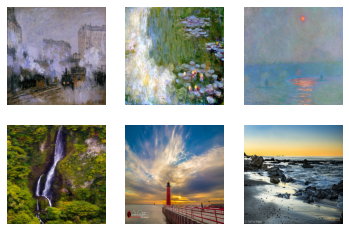

In [10]:
def check_dataset():
  dataset_ = gen_dataset()
  for i in range(3):
    img_A, img_B = next(dataset_)
    img_A = (img_A + 1) * 127.5
    img_B = (img_B + 1) * 127.5
    plt.subplot(2, 3, 1+i)
    plt.axis("off")
    plt.imshow(img_A.astype("uint8"))

    plt.subplot(2, 3, 4+i)
    plt.axis("off")
    plt.imshow(img_B.astype("uint8"))


check_dataset()


In [11]:
def resnet_block(n_filters, input_layer):
  init = RandomNormal(stddev=0.02)
  # as strides = 1, the shape is invariant
  g = Conv2D(n_filters, (3, 3), padding="same", kernel_initializer=init)(input_layer)
  g = InstanceNormalization(axis=-1)(g)
  g = Activation("relu")(g)
  g = Conv2D(n_filters, (3, 3), padding="same", kernel_initializer=init)(g)
  g = InstanceNormalization(axis=-1)(g)
  g = Concatenate()([g, input_layer])
  return g


In [12]:
def define_generator(image_shape, n_resnet=9):
  init = RandomNormal(stddev=0.02)
  in_image = Input(shape=image_shape)
  g = Conv2D(64, (7, 7), padding="same", kernel_initializer=init)(in_image)
  g = InstanceNormalization(axis=-1)(g)
  g = Activation("relu")(g)

  g = Conv2D(128, (3, 3), strides=(2, 2), padding="same", kernel_initializer=init)(g)
  g = InstanceNormalization(axis=-1)(g)
  g = Activation("relu")(g)

  g = Conv2D(256, (3, 3), strides=(2, 2), padding="same", kernel_initializer=init)(g)
  g = InstanceNormalization(axis=-1)(g)
  g = Activation("relu")(g)

  for _ in range(n_resnet):
    g = resnet_block(128, g)

  g = Conv2DTranspose(128, (3, 3), strides=(2, 2), padding="same", kernel_initializer=init)(g)
  g = InstanceNormalization(axis=-1)(g)
  g = Activation("relu")(g)

  g = Conv2DTranspose(64, (3, 3), strides=(2, 2), padding="same", kernel_initializer=init)(g)
  g = InstanceNormalization(axis=-1)(g)

  g = Conv2D(3, (7, 7), padding="same", kernel_initializer=init)(g)
  g = InstanceNormalization(axis=-1)(g)
  out_image = Activation("tanh")(g)
  model = Model(in_image, out_image)

  return model


In [13]:
def define_discriminator(image_shape):
  init = RandomNormal(stddev=0.02)
  in_image = Input(shape=image_shape)
  d = Conv2D(64, (4, 4), strides=2, padding="same", kernel_initializer=init)(in_image)
  d = LeakyReLU(alpha=0.2)(d)

  d = Conv2D(128, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(d)
  d = InstanceNormalization(axis=-1)(d)
  d = LeakyReLU(alpha=0.2)(d)

  d = Conv2D(256, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(d)
  d = InstanceNormalization(axis=-1)(d)
  d = LeakyReLU(alpha=0.2)(d)

  d = Conv2D(512, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(d)
  d = InstanceNormalization(axis=-1)(d)
  d = LeakyReLU(alpha=0.2)(d)

  d = Conv2D(512, (4, 4), padding="same", kernel_initializer=init)(d)
  d = InstanceNormalization(axis=-1)(d)
  d = LeakyReLU(alpha=0.2)(d)

  patch_out = Conv2D(1, (4, 4), padding="same", kernel_initializer=init)(d)
  model = Model(in_image, patch_out)
  return model


In [14]:
x = tf.random.normal([1, 256, 256, 3])
disc = define_discriminator((256, 256, 3))
print(tf.shape(disc(x)))

tf.Tensor([ 1 16 16  1], shape=(4,), dtype=int32)


In [15]:
def define_composite_model(g_model_AB, d_model_B, g_model_BA, image_shape):
  # adversarial loss
  input_gen = Input(shape=image_shape)
  g_AB = g_model_AB(input_gen)
  critic = d_model_B(g_AB)

  # identity loss
  # we just calculate the identity from B to B
  # we will define quite the same model from opposite direction, which will take care of the reverse identity loss
  input_B_id = Input(shape=image_shape)
  output_B_id = g_model_AB(input_B_id)

  # cycle loss - forward
  g_ABA_cycle = g_model_BA(g_AB)

  # cycle loss - backward
  gen_BA_out = g_model_BA(input_B_id)
  g_BAB_cycle = g_model_AB(gen_BA_out)

  # define model graph
  model = Model([input_gen, input_B_id], [critic, output_B_id, g_ABA_cycle, g_BAB_cycle])
  return model


In [16]:
dataset = gen_dataset()
img_A, img_B = next(dataset)
image_shape = img_A.shape
print("image_shape", image_shape)

random_state 26
image_shape (256, 256, 3)


In [17]:
def update_image_pool(pool, images, max_size=50):
  selected = []

  for image in images:
    if len(pool) < max_size:
      # stock the pool
      pool.append(image)
      selected.append(image)
    elif random() < 0.5:
      # use image, but don't add it to the pool
      selected.append(image)
    else:
      # replace an existing image and use replaced image
      index = randint(0, len(pool))
      selected.append(pool[index])
      pool[index] = image
  return asarray(selected)


In [18]:
def update_fake_image_pool(pool, images, max_size=50):
  selected = []
  
  for image in images:
    if len(pool) < max_size:
      pool.append(image)
      selected.append(image)
    elif random() < 0.5:
      selected.append(image)
    else:
      # take one from the pool and and update the pool
      # the pool may contain new image that we never
      index = randint(0, len(pool))
      selected.append(pool[index])
      pool[index] = image
      
  return asarray(selected)

## Start Training

In [19]:
g_model_AtoB = define_generator(image_shape)
g_model_BtoA = define_generator(image_shape)
d_model_A = define_discriminator(image_shape)
d_model_B = define_discriminator(image_shape)
c_model_AtoB = define_composite_model(g_model_AtoB, d_model_B, g_model_BtoA, image_shape)
c_model_BtoA = define_composite_model(g_model_BtoA, d_model_A, g_model_AtoB, image_shape)

In [20]:
n_epochs, n_batch, = 100, 1
n_patch = d_model_A.output_shape[1]


In [21]:
poolA = []
poolB = []
batch_per_epoch = int(n_sample/n_epochs)
n_steps = batch_per_epoch * n_epochs


In [22]:
n_steps


500

In [25]:

def show_result(step):
  dataset_ = gen_dataset()
  fig = plt.figure()
  fig.set_figheight(10)
  fig.set_figwidth(10)

  for i in range(3):
    if i == 0:
      pixel = load_img_from_path("James.png")
      transitted_img = g_model_BtoA.predict(np.array([pixel]))
      cycle_B = g_model_AtoB.predict(transitted_img)
       
      img_B = (pixel + 1) * 127.5
      fake_A = (transitted_img[0] + 1) * 127.5
      cycle_B = (cycle_B[0] + 1) * 127.5
      
    else:
      _, img_B = next(dataset_)
      fake_A = g_model_BtoA.predict(np.array([img_B]))
      cycle_B = g_model_AtoB.predict(fake_A)
      img_B = (img_B + 1) * 127.5
      fake_A = (fake_A[0] + 1) * 127.5
      cycle_B = (cycle_B[0] + 1) * 127.5
      
    
    
    plt.subplot(3, 3, 1+i)
    plt.axis("off")
    plt.imshow(img_B.astype("uint8"))

    plt.subplot(3, 3, 4+i)
    plt.axis("off")
    plt.imshow(fake_A.astype("uint8"))
    
    plt.subplot(3, 3, 7+i)
    plt.axis("off")
    plt.imshow(cycle_B.astype("uint8"))
    plt.savefig(f'result_{str(step).zfill(2)}.png')
    
  plt.show()


step 0
random_state 72


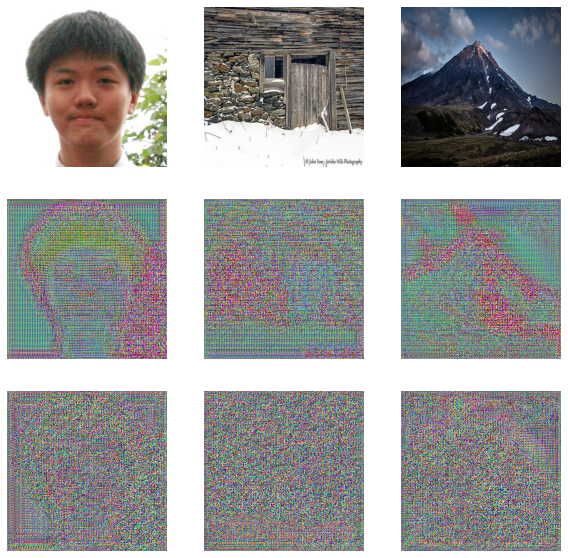

>1, loss_AB[18.840] loss_BA[17.711]
step 1
>2, loss_AB[16.967] loss_BA[15.498]
step 2
>3, loss_AB[19.792] loss_BA[27.366]
step 3
>4, loss_AB[14.727] loss_BA[19.107]
step 4
>5, loss_AB[24.568] loss_BA[20.156]
step 5
>6, loss_AB[18.442] loss_BA[11.756]
step 6
>7, loss_AB[12.994] loss_BA[12.832]
step 7
>8, loss_AB[13.901] loss_BA[11.975]
step 8
>9, loss_AB[11.634] loss_BA[13.863]
step 9
>10, loss_AB[10.273] loss_BA[11.707]
step 10
random_state 92


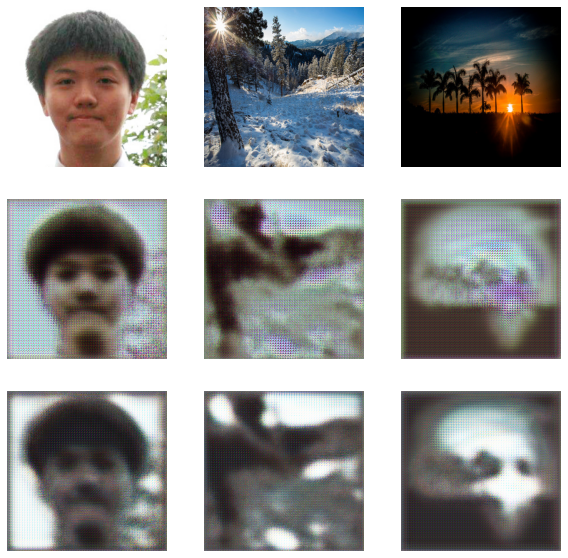

>11, loss_AB[12.248] loss_BA[11.829]
step 11
>12, loss_AB[10.727] loss_BA[11.582]
step 12
>13, loss_AB[9.382] loss_BA[9.543]
step 13
>14, loss_AB[10.392] loss_BA[9.894]
step 14
>15, loss_AB[11.673] loss_BA[12.697]
step 15
>16, loss_AB[11.379] loss_BA[13.068]
step 16
>17, loss_AB[10.327] loss_BA[10.701]
step 17
>18, loss_AB[10.864] loss_BA[9.584]
step 18
>19, loss_AB[9.457] loss_BA[8.752]
step 19
>20, loss_AB[10.356] loss_BA[10.951]
step 20
random_state 54


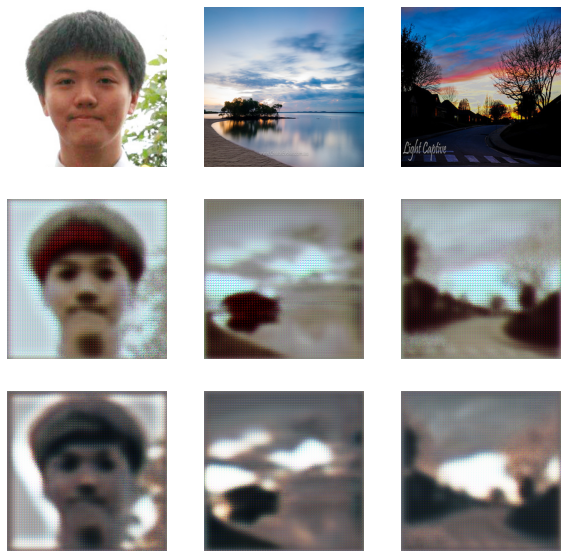

>21, loss_AB[12.471] loss_BA[11.968]
step 21
>22, loss_AB[11.858] loss_BA[9.857]
step 22
>23, loss_AB[10.349] loss_BA[10.378]
step 23
>24, loss_AB[8.486] loss_BA[8.136]
step 24
>25, loss_AB[8.014] loss_BA[7.711]
step 25
>26, loss_AB[8.419] loss_BA[7.919]
step 26
>27, loss_AB[7.515] loss_BA[6.928]
step 27
>28, loss_AB[8.200] loss_BA[7.954]
step 28
>29, loss_AB[8.058] loss_BA[7.603]
step 29
>30, loss_AB[6.207] loss_BA[5.716]
step 30
random_state 70


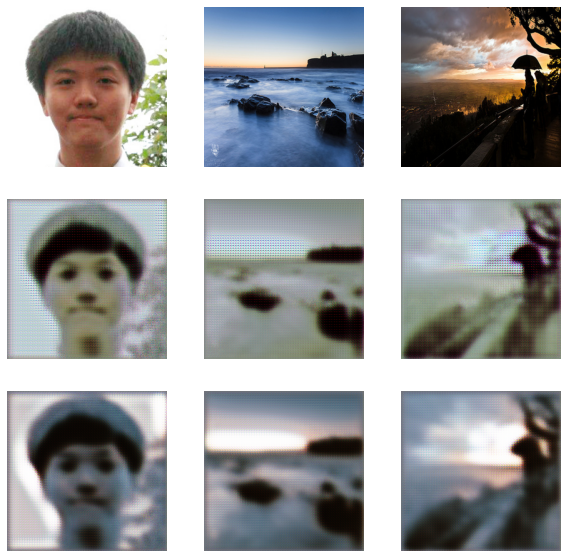

>31, loss_AB[7.546] loss_BA[6.678]
step 31
>32, loss_AB[9.807] loss_BA[8.402]
step 32
>33, loss_AB[9.615] loss_BA[7.906]
step 33
>34, loss_AB[8.681] loss_BA[8.611]
step 34
>35, loss_AB[7.591] loss_BA[7.336]
step 35
>36, loss_AB[6.969] loss_BA[6.266]
step 36
>37, loss_AB[9.533] loss_BA[8.373]
step 37
>38, loss_AB[9.608] loss_BA[9.614]
step 38
>39, loss_AB[6.714] loss_BA[6.211]
step 39
>40, loss_AB[8.985] loss_BA[7.732]
step 40
random_state 29


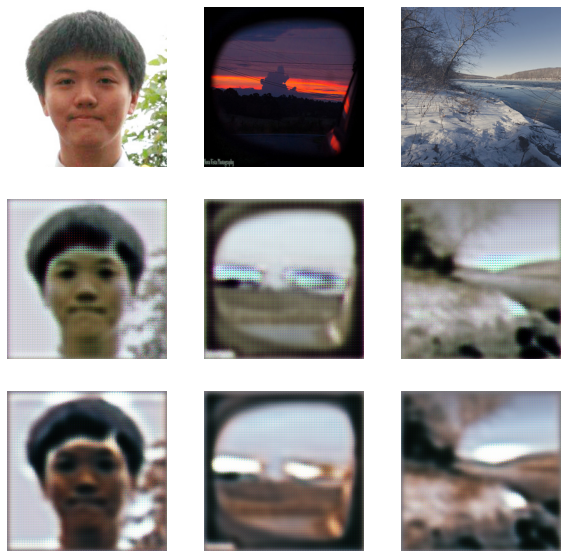

>41, loss_AB[7.841] loss_BA[7.012]
step 41
>42, loss_AB[11.457] loss_BA[13.135]
step 42
>43, loss_AB[9.107] loss_BA[8.175]
step 43
>44, loss_AB[7.863] loss_BA[7.344]
step 44
>45, loss_AB[5.659] loss_BA[5.217]
step 45
>46, loss_AB[8.455] loss_BA[8.512]
step 46
>47, loss_AB[7.268] loss_BA[7.014]
step 47
>48, loss_AB[7.018] loss_BA[6.865]
step 48
>49, loss_AB[8.568] loss_BA[7.415]
step 49
>50, loss_AB[13.626] loss_BA[12.937]
step 50
random_state 16


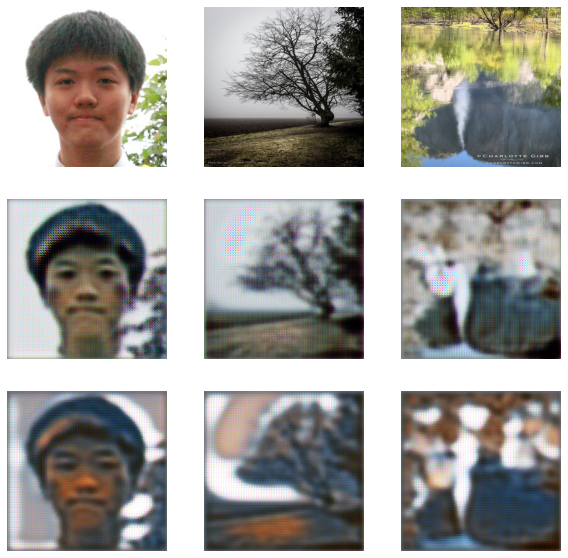

>51, loss_AB[7.938] loss_BA[7.142]
step 51
>52, loss_AB[8.494] loss_BA[6.672]
step 52
>53, loss_AB[6.322] loss_BA[5.947]
step 53
>54, loss_AB[8.307] loss_BA[7.433]
step 54
>55, loss_AB[7.201] loss_BA[7.167]
step 55
>56, loss_AB[9.394] loss_BA[8.416]
step 56
>57, loss_AB[8.143] loss_BA[7.980]
step 57
>58, loss_AB[8.890] loss_BA[8.719]
step 58
>59, loss_AB[6.465] loss_BA[6.508]
step 59
>60, loss_AB[5.479] loss_BA[5.248]
step 60
random_state 48


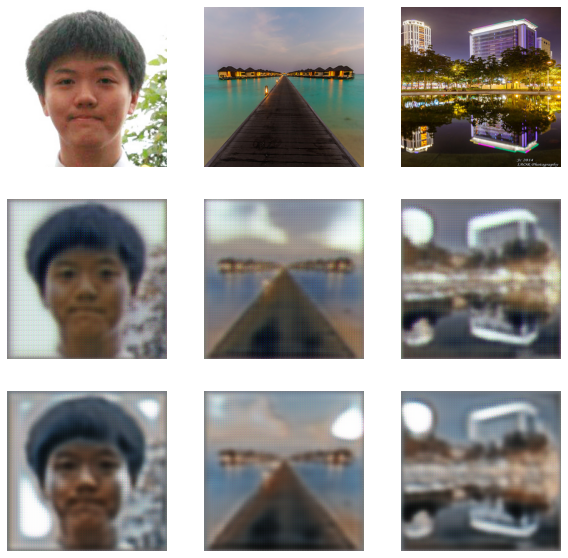

>61, loss_AB[6.861] loss_BA[6.574]
step 61
>62, loss_AB[8.181] loss_BA[8.456]
step 62
>63, loss_AB[6.987] loss_BA[6.998]
step 63
>64, loss_AB[7.890] loss_BA[7.059]
step 64
>65, loss_AB[5.579] loss_BA[5.503]
step 65
>66, loss_AB[5.395] loss_BA[6.256]
step 66
>67, loss_AB[10.001] loss_BA[9.707]
step 67
>68, loss_AB[6.777] loss_BA[6.582]
step 68
>69, loss_AB[5.801] loss_BA[5.355]
step 69
>70, loss_AB[8.522] loss_BA[6.500]
step 70
random_state 48


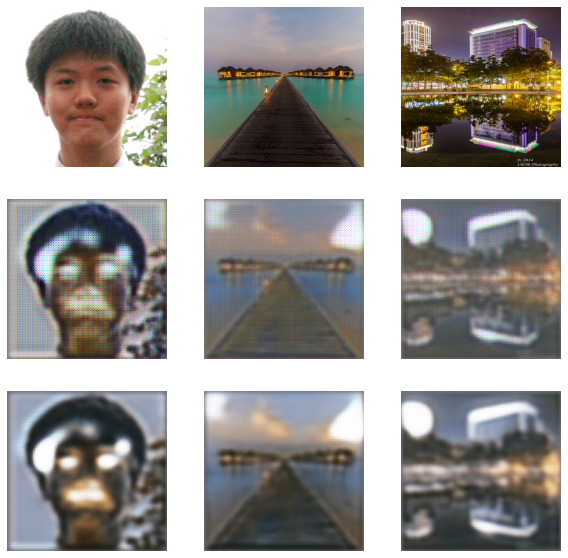

>71, loss_AB[5.070] loss_BA[4.882]
step 71
>72, loss_AB[12.920] loss_BA[11.617]
step 72
>73, loss_AB[6.546] loss_BA[7.081]
step 73
>74, loss_AB[8.563] loss_BA[9.552]
step 74
>75, loss_AB[7.032] loss_BA[6.158]
step 75
>76, loss_AB[10.954] loss_BA[8.897]
step 76
>77, loss_AB[8.377] loss_BA[9.485]
step 77
>78, loss_AB[8.390] loss_BA[7.559]
step 78
>79, loss_AB[8.551] loss_BA[7.225]
step 79
>80, loss_AB[7.965] loss_BA[8.341]
step 80
random_state 46


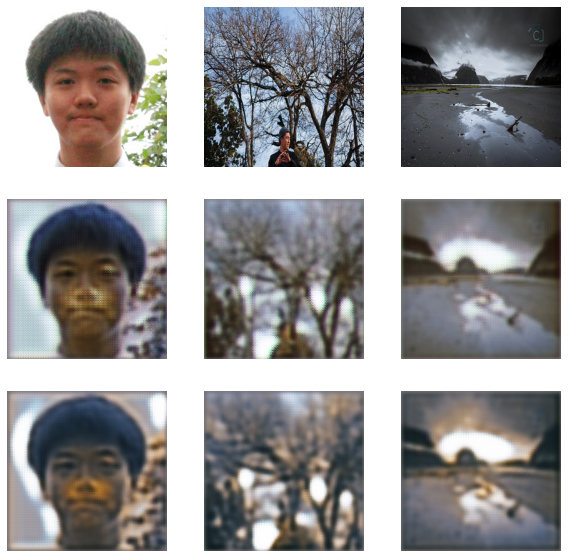

>81, loss_AB[5.614] loss_BA[5.413]
step 81
>82, loss_AB[9.507] loss_BA[8.454]
step 82
>83, loss_AB[4.410] loss_BA[4.142]
step 83
>84, loss_AB[11.485] loss_BA[9.169]
step 84
>85, loss_AB[7.271] loss_BA[7.482]
step 85
>86, loss_AB[8.119] loss_BA[9.420]
step 86
>87, loss_AB[11.460] loss_BA[11.380]
step 87
>88, loss_AB[6.450] loss_BA[6.254]
step 88
>89, loss_AB[9.116] loss_BA[8.099]
step 89
>90, loss_AB[6.806] loss_BA[6.728]
step 90
random_state 48


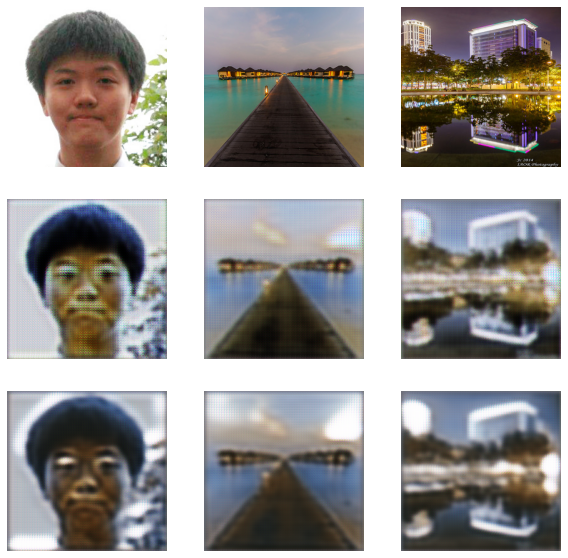

>91, loss_AB[7.984] loss_BA[7.163]
step 91
>92, loss_AB[12.122] loss_BA[10.100]
step 92
>93, loss_AB[7.609] loss_BA[8.133]
step 93
>94, loss_AB[10.086] loss_BA[10.565]
step 94
>95, loss_AB[9.641] loss_BA[7.991]
step 95
>96, loss_AB[6.696] loss_BA[6.352]
step 96
>97, loss_AB[7.675] loss_BA[7.184]
step 97
>98, loss_AB[6.534] loss_BA[6.216]
step 98
>99, loss_AB[8.546] loss_BA[7.908]
step 99
>100, loss_AB[6.418] loss_BA[5.749]
step 100
random_state 54


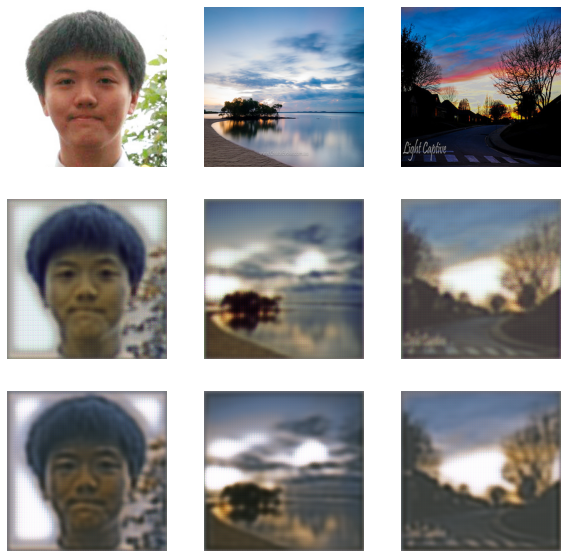

>101, loss_AB[7.354] loss_BA[7.671]
step 101
>102, loss_AB[8.935] loss_BA[8.259]
step 102
>103, loss_AB[7.946] loss_BA[7.573]
step 103
>104, loss_AB[6.316] loss_BA[6.584]
step 104
>105, loss_AB[11.099] loss_BA[11.211]
step 105
>106, loss_AB[6.849] loss_BA[6.128]
step 106
>107, loss_AB[8.123] loss_BA[6.102]
step 107
>108, loss_AB[11.613] loss_BA[10.131]
step 108
>109, loss_AB[10.696] loss_BA[8.432]
step 109
>110, loss_AB[5.541] loss_BA[5.587]
step 110
random_state 42


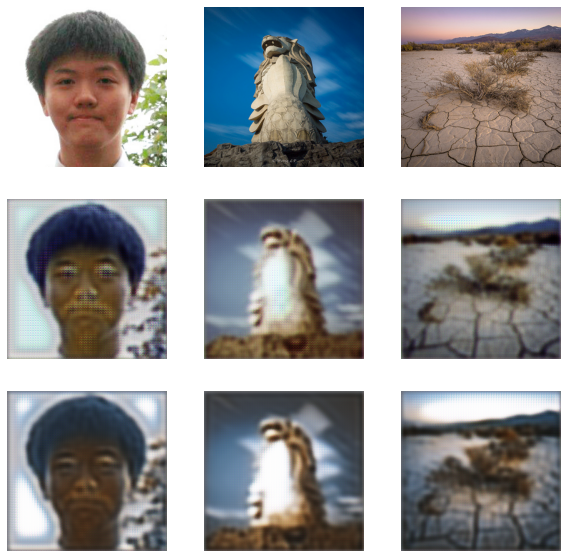

>111, loss_AB[8.210] loss_BA[7.283]
step 111
>112, loss_AB[6.925] loss_BA[6.181]
step 112
>113, loss_AB[6.789] loss_BA[6.297]
step 113
>114, loss_AB[5.337] loss_BA[4.432]
step 114
>115, loss_AB[7.330] loss_BA[7.241]
step 115
>116, loss_AB[6.632] loss_BA[6.262]
step 116
>117, loss_AB[6.312] loss_BA[6.603]
step 117
>118, loss_AB[8.175] loss_BA[7.759]
step 118
>119, loss_AB[6.854] loss_BA[6.187]
step 119
>120, loss_AB[6.837] loss_BA[6.045]
step 120
random_state 78


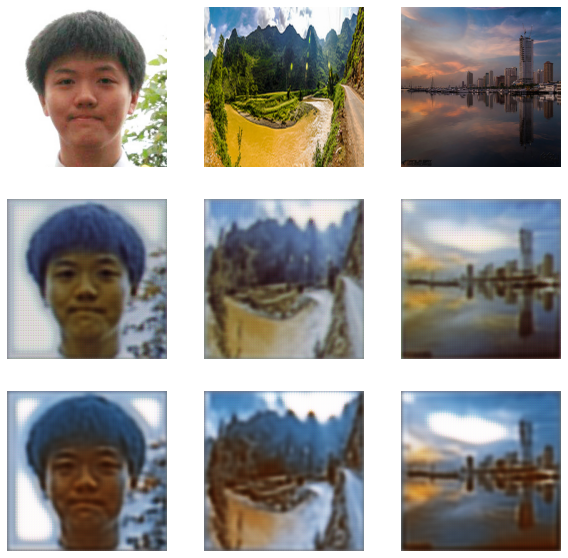

>121, loss_AB[7.662] loss_BA[7.445]
step 121
>122, loss_AB[6.271] loss_BA[5.288]
step 122
>123, loss_AB[9.613] loss_BA[7.610]
step 123
>124, loss_AB[6.529] loss_BA[5.434]
step 124
>125, loss_AB[10.363] loss_BA[8.247]
step 125
>126, loss_AB[7.179] loss_BA[6.206]
step 126
>127, loss_AB[9.113] loss_BA[7.510]
step 127
>128, loss_AB[6.835] loss_BA[6.567]
step 128
>129, loss_AB[7.963] loss_BA[7.039]
step 129
>130, loss_AB[6.213] loss_BA[5.339]
step 130
random_state 85


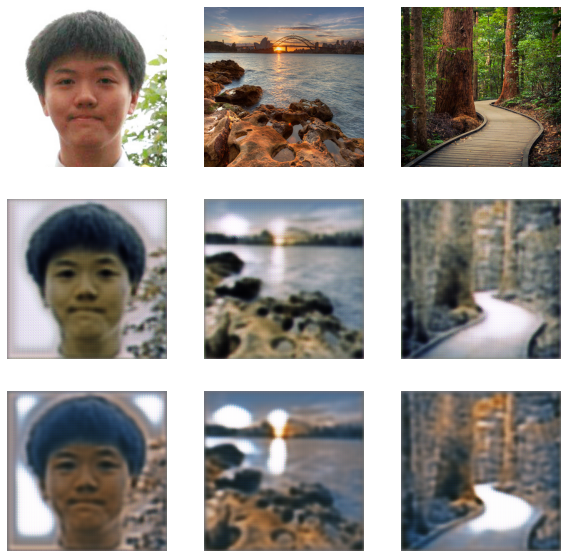

>131, loss_AB[7.568] loss_BA[5.907]
step 131
>132, loss_AB[8.432] loss_BA[6.774]
step 132
>133, loss_AB[6.059] loss_BA[5.223]
step 133
>134, loss_AB[7.446] loss_BA[8.596]
step 134
>135, loss_AB[7.259] loss_BA[6.773]
step 135
>136, loss_AB[6.843] loss_BA[7.524]
step 136
>137, loss_AB[8.448] loss_BA[7.086]
step 137
>138, loss_AB[5.400] loss_BA[5.131]
step 138
>139, loss_AB[7.174] loss_BA[6.593]
step 139
>140, loss_AB[6.733] loss_BA[6.039]
step 140
random_state 88


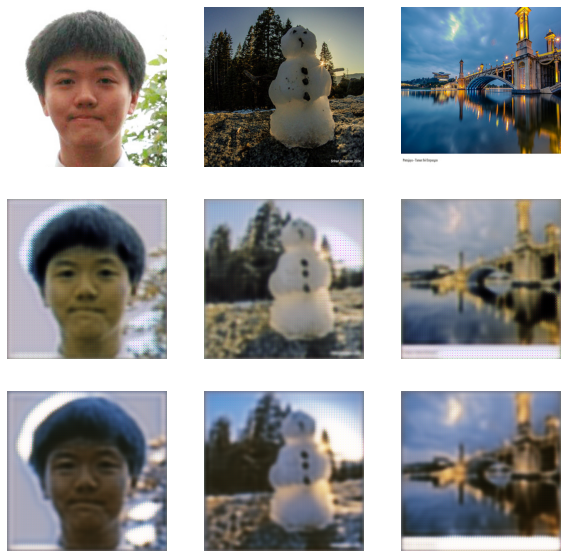

>141, loss_AB[7.645] loss_BA[9.168]
step 141
>142, loss_AB[5.658] loss_BA[5.466]
step 142
>143, loss_AB[7.068] loss_BA[7.566]
step 143
>144, loss_AB[6.528] loss_BA[5.639]
step 144
>145, loss_AB[8.555] loss_BA[7.149]
step 145
>146, loss_AB[8.131] loss_BA[5.962]
step 146
>147, loss_AB[4.485] loss_BA[4.037]
step 147
>148, loss_AB[6.663] loss_BA[6.010]
step 148
>149, loss_AB[7.337] loss_BA[5.916]
step 149
>150, loss_AB[7.299] loss_BA[6.096]
step 150
random_state 2


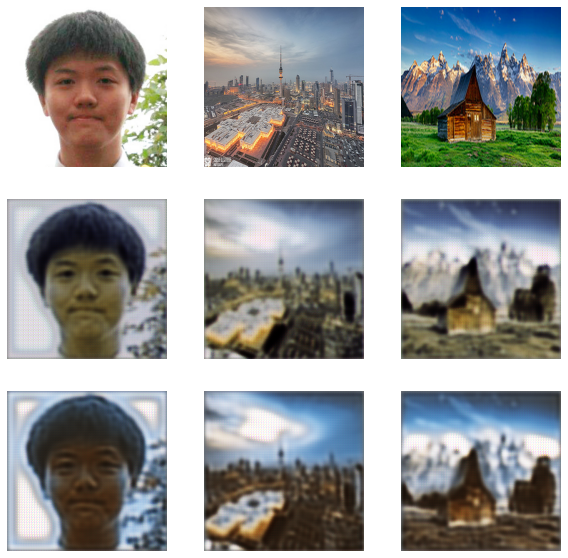

>151, loss_AB[6.453] loss_BA[5.843]
step 151
>152, loss_AB[6.776] loss_BA[6.432]
step 152
>153, loss_AB[8.121] loss_BA[7.501]
step 153
>154, loss_AB[6.753] loss_BA[5.524]
step 154
>155, loss_AB[5.940] loss_BA[4.976]
step 155
>156, loss_AB[8.284] loss_BA[7.693]
step 156
>157, loss_AB[8.008] loss_BA[6.600]
step 157
>158, loss_AB[6.256] loss_BA[5.429]
step 158
>159, loss_AB[7.216] loss_BA[6.591]
step 159
>160, loss_AB[5.429] loss_BA[5.202]
step 160
random_state 91


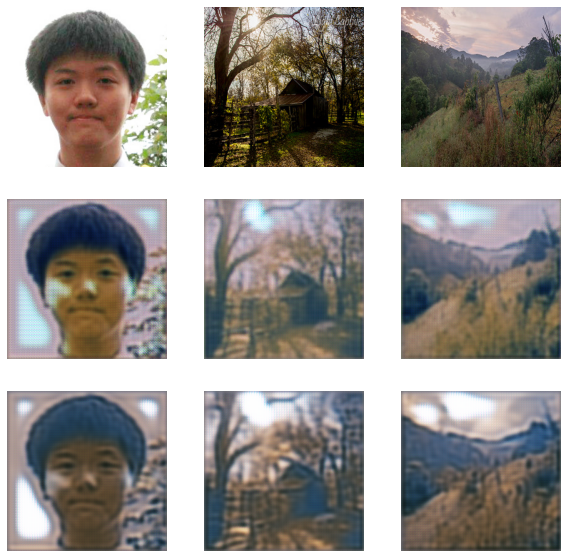

>161, loss_AB[7.171] loss_BA[6.510]
step 161
>162, loss_AB[6.177] loss_BA[6.195]
step 162
>163, loss_AB[6.695] loss_BA[5.873]
step 163
>164, loss_AB[9.016] loss_BA[8.359]
step 164
>165, loss_AB[4.562] loss_BA[4.232]
step 165
>166, loss_AB[10.381] loss_BA[7.999]
step 166
>167, loss_AB[6.666] loss_BA[6.235]
step 167
>168, loss_AB[7.544] loss_BA[5.620]
step 168
>169, loss_AB[9.316] loss_BA[10.381]
step 169
>170, loss_AB[10.444] loss_BA[10.264]
step 170
random_state 8


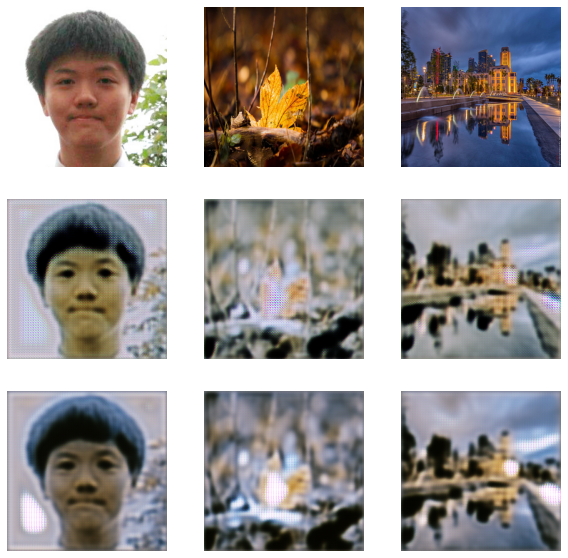

>171, loss_AB[5.501] loss_BA[5.289]
step 171
>172, loss_AB[7.474] loss_BA[6.097]
step 172
>173, loss_AB[12.904] loss_BA[9.711]
step 173
>174, loss_AB[7.312] loss_BA[6.489]
step 174
>175, loss_AB[6.759] loss_BA[6.133]
step 175
>176, loss_AB[5.675] loss_BA[5.286]
step 176
>177, loss_AB[5.314] loss_BA[4.667]
step 177
>178, loss_AB[5.213] loss_BA[4.343]
step 178
>179, loss_AB[7.081] loss_BA[5.696]
step 179
>180, loss_AB[5.830] loss_BA[5.222]
step 180
random_state 92


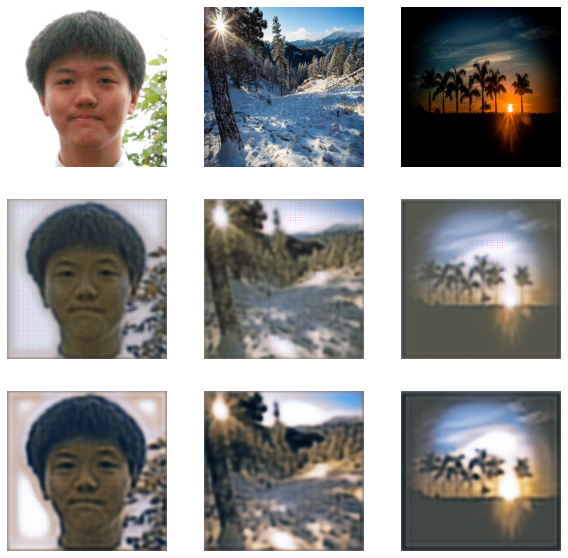

>181, loss_AB[7.279] loss_BA[7.253]
step 181
>182, loss_AB[5.910] loss_BA[5.964]
step 182
>183, loss_AB[14.591] loss_BA[12.177]
step 183
>184, loss_AB[4.845] loss_BA[4.794]
step 184
>185, loss_AB[6.181] loss_BA[5.514]
step 185
>186, loss_AB[6.867] loss_BA[7.096]
step 186
>187, loss_AB[7.038] loss_BA[7.092]
step 187
>188, loss_AB[6.584] loss_BA[6.131]
step 188
>189, loss_AB[4.378] loss_BA[4.366]
step 189
>190, loss_AB[6.702] loss_BA[7.305]
step 190
random_state 69


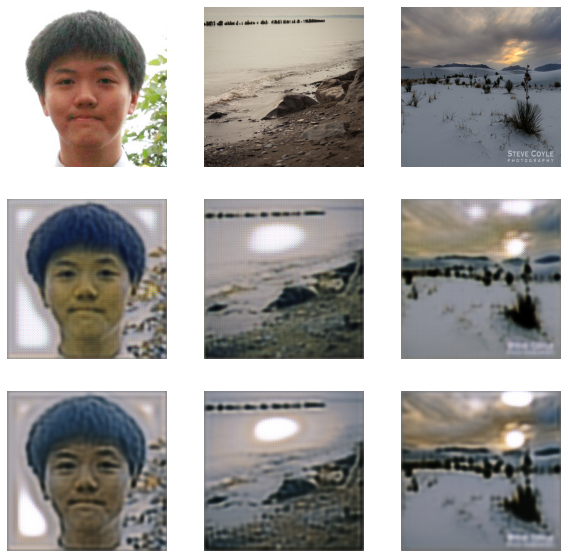

>191, loss_AB[5.528] loss_BA[5.333]
step 191
>192, loss_AB[7.125] loss_BA[6.826]
step 192
>193, loss_AB[8.366] loss_BA[9.529]
step 193
>194, loss_AB[10.884] loss_BA[11.079]
step 194
>195, loss_AB[4.386] loss_BA[4.003]
step 195
>196, loss_AB[6.617] loss_BA[6.285]
step 196
>197, loss_AB[12.566] loss_BA[10.985]
step 197
>198, loss_AB[6.927] loss_BA[5.918]
step 198
>199, loss_AB[9.690] loss_BA[10.039]
step 199
>200, loss_AB[10.407] loss_BA[9.514]
step 200
random_state 86


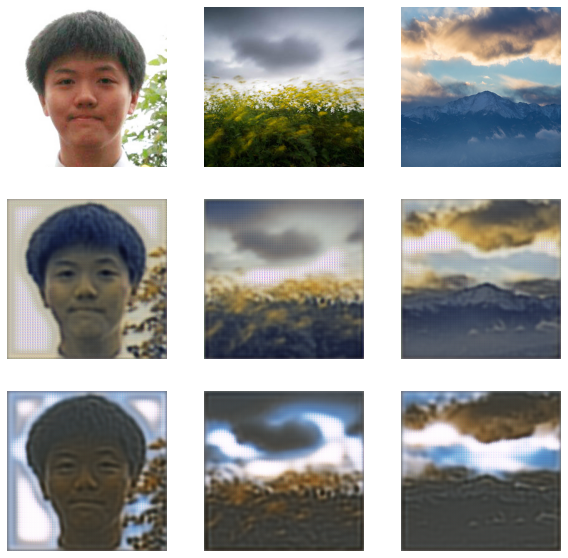

>201, loss_AB[6.335] loss_BA[5.477]
step 201
>202, loss_AB[6.746] loss_BA[5.705]
step 202
>203, loss_AB[5.385] loss_BA[6.296]
step 203
>204, loss_AB[5.650] loss_BA[4.581]
step 204
>205, loss_AB[7.392] loss_BA[6.320]
step 205
>206, loss_AB[4.978] loss_BA[4.460]
step 206
>207, loss_AB[7.644] loss_BA[6.699]
step 207
>208, loss_AB[6.885] loss_BA[6.260]
step 208
>209, loss_AB[7.453] loss_BA[7.442]
step 209
>210, loss_AB[7.394] loss_BA[6.597]
step 210
random_state 53


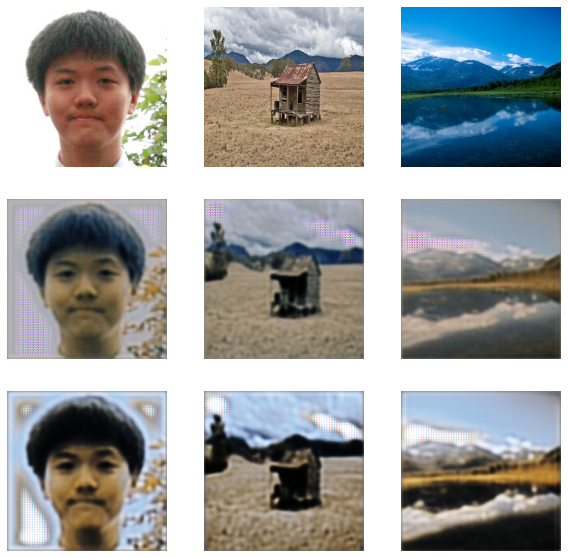

>211, loss_AB[9.407] loss_BA[8.565]
step 211
>212, loss_AB[9.206] loss_BA[9.732]
step 212
>213, loss_AB[8.326] loss_BA[9.169]
step 213
>214, loss_AB[4.950] loss_BA[4.551]
step 214
>215, loss_AB[5.595] loss_BA[5.430]
step 215
>216, loss_AB[5.582] loss_BA[4.875]
step 216
>217, loss_AB[7.354] loss_BA[6.265]
step 217
>218, loss_AB[6.344] loss_BA[6.042]
step 218
>219, loss_AB[7.995] loss_BA[9.395]
step 219
>220, loss_AB[7.207] loss_BA[6.764]
step 220
random_state 82


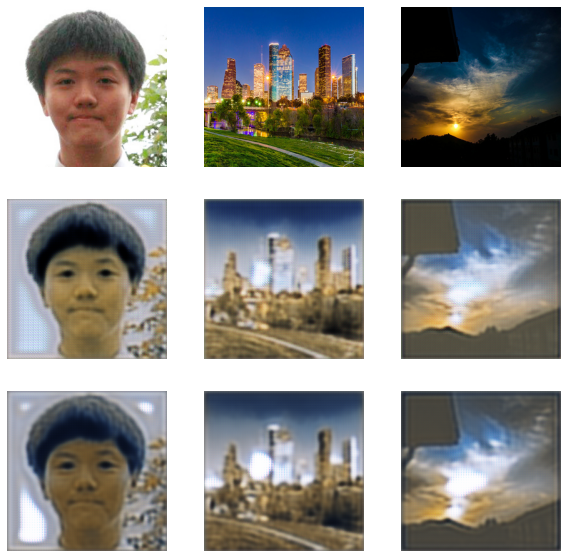

>221, loss_AB[8.529] loss_BA[8.877]
step 221
>222, loss_AB[10.500] loss_BA[8.944]
step 222
>223, loss_AB[9.563] loss_BA[10.901]
step 223
>224, loss_AB[5.760] loss_BA[4.835]
step 224
>225, loss_AB[6.974] loss_BA[6.188]
step 225
>226, loss_AB[6.996] loss_BA[6.030]
step 226
>227, loss_AB[5.073] loss_BA[4.661]
step 227
>228, loss_AB[6.221] loss_BA[4.795]
step 228
>229, loss_AB[11.105] loss_BA[11.298]
step 229
>230, loss_AB[5.868] loss_BA[5.630]
step 230
random_state 3


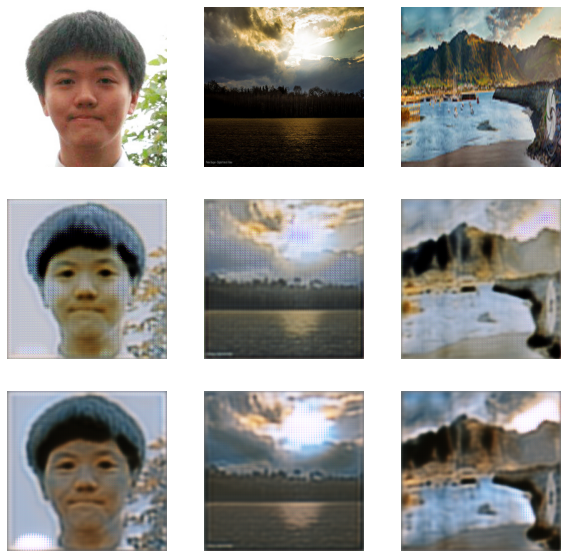

>231, loss_AB[7.592] loss_BA[7.226]
step 231
>232, loss_AB[5.948] loss_BA[5.389]
step 232
>233, loss_AB[6.578] loss_BA[5.124]
step 233
>234, loss_AB[5.894] loss_BA[5.071]
step 234
>235, loss_AB[4.836] loss_BA[4.244]
step 235
>236, loss_AB[6.857] loss_BA[7.623]
step 236
>237, loss_AB[7.880] loss_BA[6.416]
step 237
>238, loss_AB[4.582] loss_BA[3.976]
step 238
>239, loss_AB[8.627] loss_BA[7.224]
step 239
>240, loss_AB[3.991] loss_BA[3.781]
step 240
random_state 8


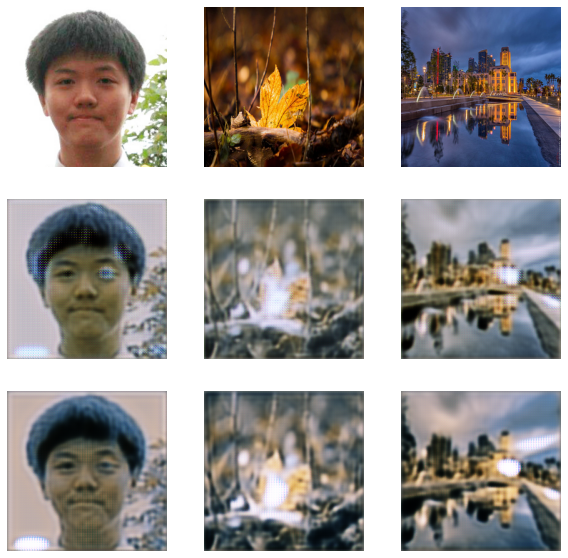

>241, loss_AB[7.763] loss_BA[7.432]
step 241
>242, loss_AB[7.899] loss_BA[7.262]
step 242
>243, loss_AB[6.157] loss_BA[5.412]
step 243
>244, loss_AB[7.453] loss_BA[6.242]
step 244
>245, loss_AB[6.212] loss_BA[6.020]
step 245
>246, loss_AB[7.136] loss_BA[6.822]
step 246
>247, loss_AB[6.952] loss_BA[6.128]
step 247
>248, loss_AB[6.936] loss_BA[6.395]
step 248
>249, loss_AB[6.512] loss_BA[5.805]
step 249
>250, loss_AB[6.867] loss_BA[5.518]
step 250
random_state 55


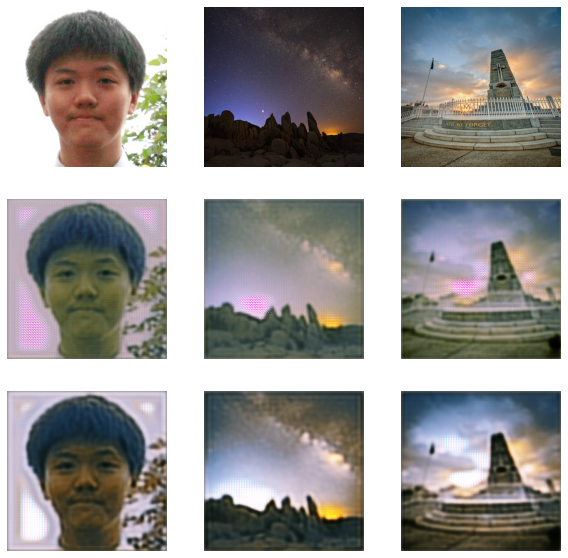

>251, loss_AB[6.623] loss_BA[6.906]
step 251
>252, loss_AB[5.022] loss_BA[4.794]
step 252
>253, loss_AB[13.254] loss_BA[11.011]
step 253
>254, loss_AB[11.148] loss_BA[9.805]
step 254
>255, loss_AB[6.796] loss_BA[6.129]
step 255
>256, loss_AB[4.723] loss_BA[3.814]
step 256
>257, loss_AB[7.176] loss_BA[7.519]
step 257
>258, loss_AB[9.202] loss_BA[9.282]
step 258
>259, loss_AB[6.316] loss_BA[5.577]
step 259
>260, loss_AB[7.400] loss_BA[7.292]
step 260
random_state 58


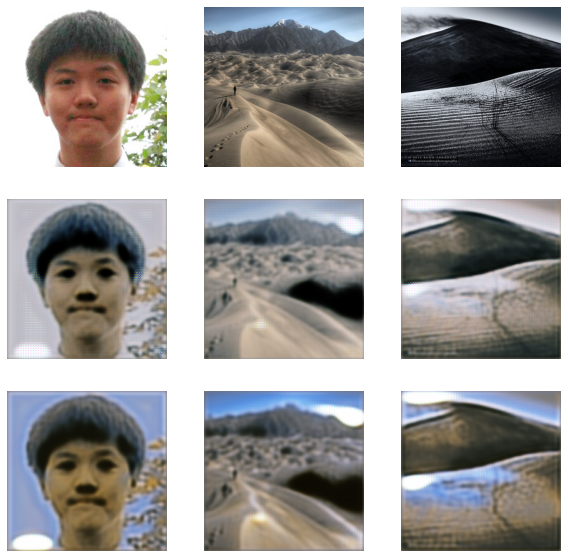

>261, loss_AB[6.017] loss_BA[5.214]
step 261
>262, loss_AB[6.061] loss_BA[5.302]
step 262
>263, loss_AB[8.697] loss_BA[7.130]
step 263
>264, loss_AB[9.518] loss_BA[6.722]
step 264
>265, loss_AB[7.054] loss_BA[6.519]
step 265
>266, loss_AB[12.021] loss_BA[10.567]
step 266
>267, loss_AB[7.492] loss_BA[5.892]
step 267
>268, loss_AB[10.318] loss_BA[10.588]
step 268
>269, loss_AB[7.792] loss_BA[6.639]
step 269
>270, loss_AB[7.746] loss_BA[7.387]
step 270
random_state 0


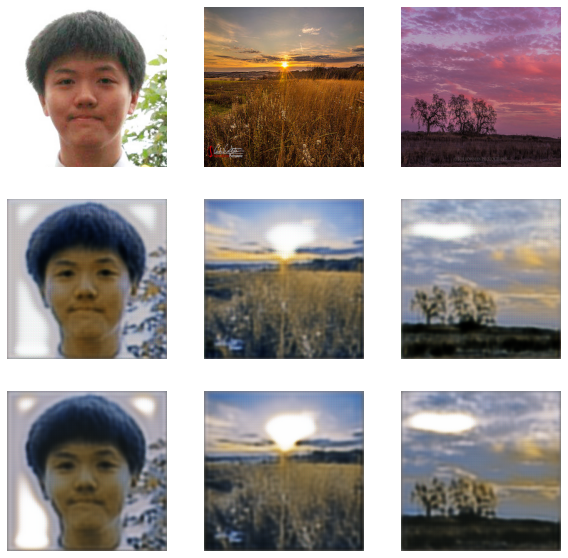

>271, loss_AB[4.163] loss_BA[4.119]
step 271
>272, loss_AB[6.199] loss_BA[5.058]
step 272
>273, loss_AB[6.915] loss_BA[6.357]
step 273
>274, loss_AB[7.445] loss_BA[7.464]
step 274
>275, loss_AB[5.140] loss_BA[4.791]
step 275
>276, loss_AB[6.589] loss_BA[6.045]
step 276
>277, loss_AB[7.496] loss_BA[6.837]
step 277
>278, loss_AB[9.449] loss_BA[8.460]
step 278
>279, loss_AB[9.781] loss_BA[8.567]
step 279
>280, loss_AB[8.198] loss_BA[7.914]
step 280
random_state 52


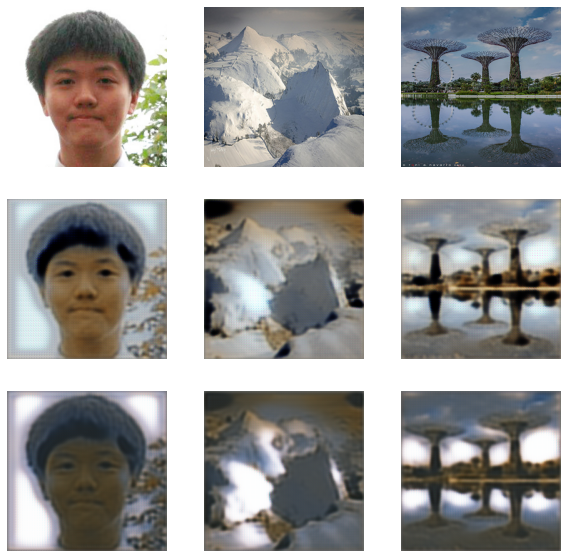

>281, loss_AB[7.627] loss_BA[6.466]
step 281
>282, loss_AB[11.206] loss_BA[8.688]
step 282
>283, loss_AB[6.788] loss_BA[6.447]
step 283
>284, loss_AB[5.706] loss_BA[4.621]
step 284
>285, loss_AB[8.853] loss_BA[7.905]
step 285
>286, loss_AB[8.933] loss_BA[8.395]
step 286
>287, loss_AB[5.429] loss_BA[5.060]
step 287
>288, loss_AB[6.303] loss_BA[6.217]
step 288
>289, loss_AB[5.915] loss_BA[5.313]
step 289
>290, loss_AB[6.117] loss_BA[6.015]
step 290
random_state 98


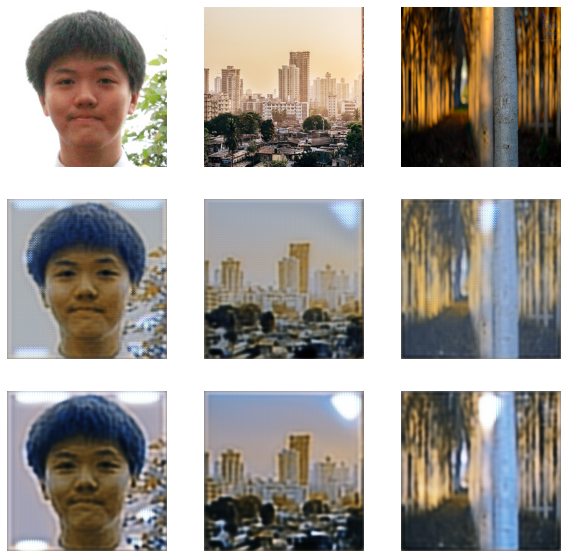

>291, loss_AB[5.691] loss_BA[5.107]
step 291
>292, loss_AB[6.029] loss_BA[6.075]
step 292
>293, loss_AB[6.943] loss_BA[6.094]
step 293
>294, loss_AB[4.732] loss_BA[4.282]
step 294
>295, loss_AB[3.703] loss_BA[3.086]
step 295
>296, loss_AB[7.645] loss_BA[6.203]
step 296
>297, loss_AB[5.487] loss_BA[4.111]
step 297
>298, loss_AB[6.384] loss_BA[5.422]
step 298
>299, loss_AB[5.536] loss_BA[4.721]
step 299
>300, loss_AB[4.480] loss_BA[4.135]
step 300
random_state 72


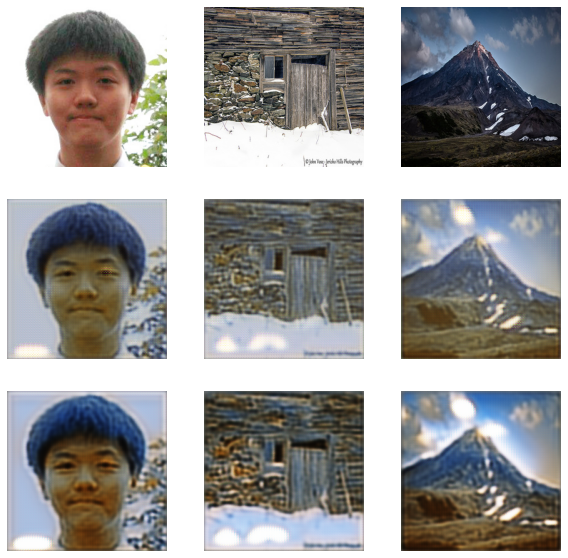

>301, loss_AB[7.737] loss_BA[6.138]
step 301
>302, loss_AB[5.794] loss_BA[4.713]
step 302
>303, loss_AB[6.925] loss_BA[5.846]
step 303
>304, loss_AB[8.733] loss_BA[7.235]
step 304
>305, loss_AB[6.142] loss_BA[5.086]
step 305
>306, loss_AB[6.618] loss_BA[5.916]
step 306
>307, loss_AB[5.790] loss_BA[5.475]
step 307
>308, loss_AB[4.456] loss_BA[4.044]
step 308
>309, loss_AB[10.736] loss_BA[7.650]
step 309
>310, loss_AB[7.853] loss_BA[6.730]
step 310
random_state 28


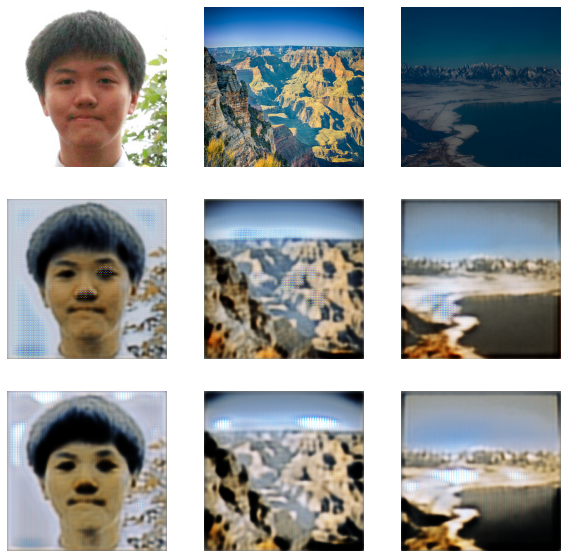

>311, loss_AB[7.458] loss_BA[5.535]
step 311
>312, loss_AB[7.263] loss_BA[6.764]
step 312
>313, loss_AB[7.818] loss_BA[7.560]
step 313
>314, loss_AB[6.716] loss_BA[6.470]
step 314
>315, loss_AB[9.722] loss_BA[9.107]
step 315
>316, loss_AB[8.847] loss_BA[6.740]
step 316
>317, loss_AB[9.975] loss_BA[9.260]
step 317
>318, loss_AB[6.773] loss_BA[6.553]
step 318
>319, loss_AB[10.644] loss_BA[9.974]
step 319
>320, loss_AB[6.443] loss_BA[5.632]
step 320
random_state 64


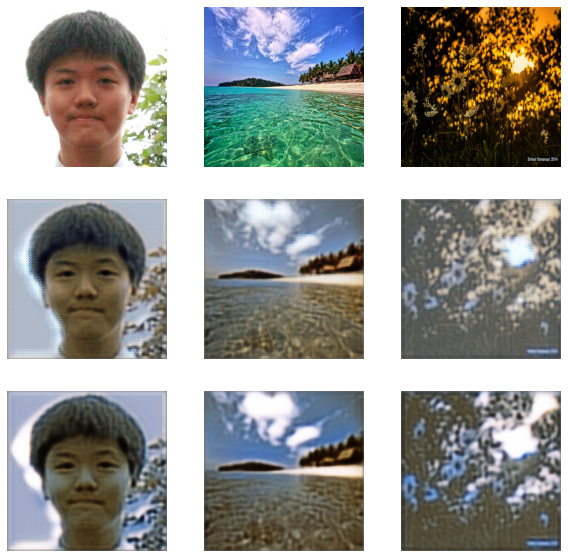

>321, loss_AB[14.240] loss_BA[12.798]
step 321
>322, loss_AB[10.692] loss_BA[9.126]
step 322
>323, loss_AB[5.105] loss_BA[5.490]
step 323
>324, loss_AB[14.554] loss_BA[14.805]
step 324
>325, loss_AB[4.931] loss_BA[4.381]
step 325
>326, loss_AB[7.149] loss_BA[6.589]
step 326
>327, loss_AB[4.107] loss_BA[4.105]
step 327
>328, loss_AB[11.486] loss_BA[10.989]
step 328
>329, loss_AB[6.357] loss_BA[5.943]
step 329
>330, loss_AB[7.175] loss_BA[6.725]
step 330
random_state 40


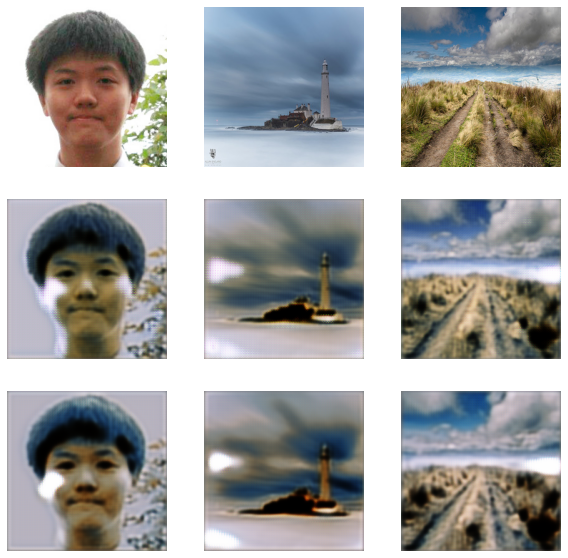

>331, loss_AB[6.269] loss_BA[5.651]
step 331
>332, loss_AB[6.142] loss_BA[6.088]
step 332
>333, loss_AB[5.348] loss_BA[4.226]
step 333
>334, loss_AB[14.128] loss_BA[10.797]
step 334
>335, loss_AB[6.067] loss_BA[6.338]
step 335
>336, loss_AB[7.739] loss_BA[7.189]
step 336
>337, loss_AB[8.716] loss_BA[6.887]
step 337
>338, loss_AB[8.164] loss_BA[9.358]
step 338
>339, loss_AB[7.380] loss_BA[6.150]
step 339
>340, loss_AB[4.283] loss_BA[4.046]
step 340
random_state 8


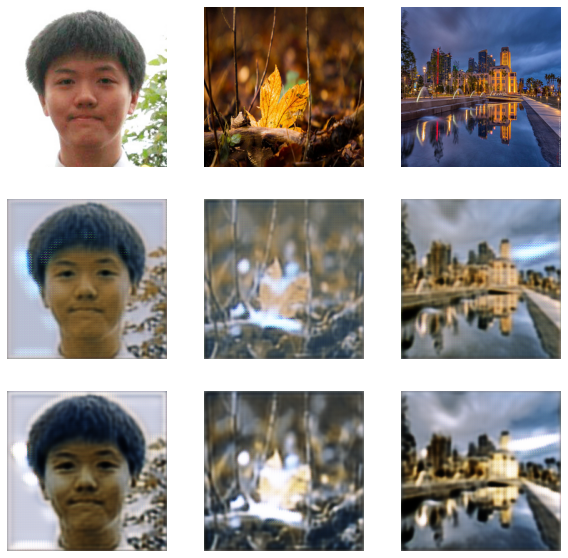

>341, loss_AB[8.302] loss_BA[7.186]
step 341
>342, loss_AB[5.209] loss_BA[5.207]
step 342
>343, loss_AB[7.046] loss_BA[5.924]
step 343
>344, loss_AB[8.120] loss_BA[6.748]
step 344
>345, loss_AB[9.752] loss_BA[8.251]
step 345
>346, loss_AB[5.175] loss_BA[4.396]
step 346
>347, loss_AB[7.511] loss_BA[7.681]
step 347
>348, loss_AB[5.815] loss_BA[7.003]
step 348
>349, loss_AB[8.594] loss_BA[7.605]
step 349
>350, loss_AB[4.818] loss_BA[4.772]
step 350
random_state 86


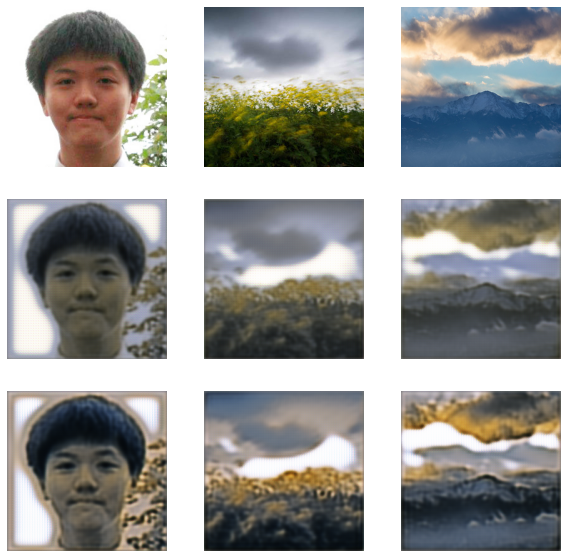

>351, loss_AB[4.574] loss_BA[3.385]
step 351
>352, loss_AB[5.487] loss_BA[5.007]
step 352
>353, loss_AB[9.501] loss_BA[7.464]
step 353
>354, loss_AB[10.839] loss_BA[9.021]
step 354
>355, loss_AB[5.076] loss_BA[4.450]
step 355
>356, loss_AB[7.508] loss_BA[7.379]
step 356
>357, loss_AB[6.030] loss_BA[5.931]
step 357
>358, loss_AB[6.218] loss_BA[5.340]
step 358
>359, loss_AB[6.347] loss_BA[5.571]
step 359
>360, loss_AB[6.271] loss_BA[6.351]
step 360
random_state 64


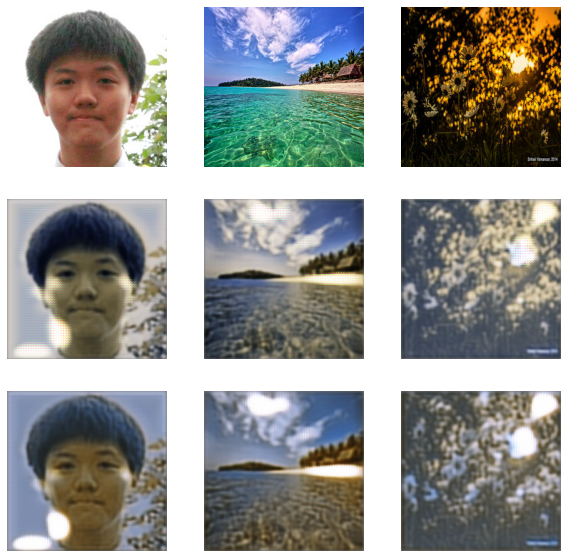

>361, loss_AB[6.949] loss_BA[5.908]
step 361
>362, loss_AB[4.791] loss_BA[4.657]
step 362
>363, loss_AB[9.930] loss_BA[7.787]
step 363
>364, loss_AB[8.436] loss_BA[7.067]
step 364
>365, loss_AB[7.326] loss_BA[7.347]
step 365
>366, loss_AB[7.411] loss_BA[6.456]
step 366
>367, loss_AB[7.019] loss_BA[5.988]
step 367
>368, loss_AB[8.519] loss_BA[7.230]
step 368
>369, loss_AB[12.196] loss_BA[11.144]
step 369
>370, loss_AB[9.615] loss_BA[9.592]
step 370
random_state 66


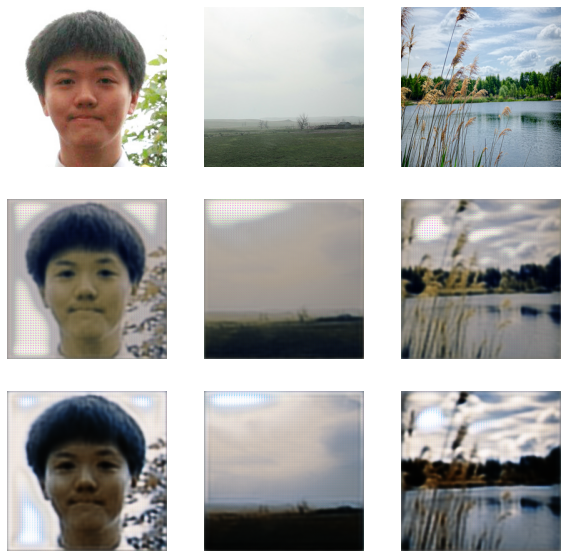

>371, loss_AB[5.329] loss_BA[4.689]
step 371
>372, loss_AB[8.432] loss_BA[6.948]
step 372
>373, loss_AB[8.651] loss_BA[7.202]
step 373
>374, loss_AB[5.458] loss_BA[5.538]
step 374
>375, loss_AB[10.770] loss_BA[8.948]
step 375
>376, loss_AB[8.119] loss_BA[7.534]
step 376
>377, loss_AB[7.919] loss_BA[7.691]
step 377
>378, loss_AB[5.843] loss_BA[5.921]
step 378
>379, loss_AB[4.305] loss_BA[4.268]
step 379
>380, loss_AB[5.627] loss_BA[4.609]
step 380
random_state 85


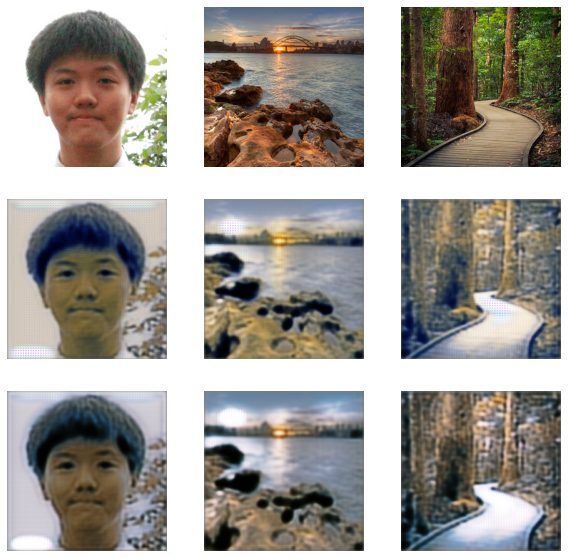

>381, loss_AB[6.842] loss_BA[6.780]
step 381
>382, loss_AB[6.995] loss_BA[5.660]
step 382
>383, loss_AB[5.090] loss_BA[4.295]
step 383
>384, loss_AB[7.665] loss_BA[6.465]
step 384
>385, loss_AB[5.893] loss_BA[5.412]
step 385
>386, loss_AB[6.151] loss_BA[5.974]
step 386
>387, loss_AB[8.203] loss_BA[6.289]
step 387
>388, loss_AB[4.802] loss_BA[4.959]
step 388
>389, loss_AB[5.838] loss_BA[5.109]
step 389
>390, loss_AB[6.554] loss_BA[6.590]
step 390
random_state 68


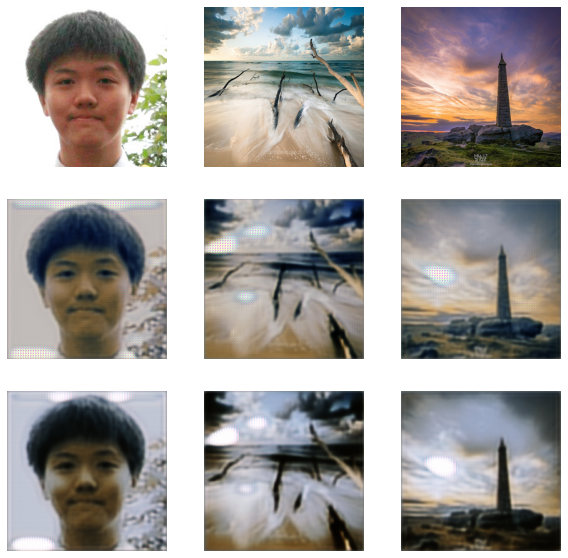

>391, loss_AB[5.666] loss_BA[4.753]
step 391
>392, loss_AB[8.247] loss_BA[7.642]
step 392
>393, loss_AB[9.673] loss_BA[9.455]
step 393
>394, loss_AB[6.488] loss_BA[5.923]
step 394
>395, loss_AB[7.640] loss_BA[6.125]
step 395
>396, loss_AB[4.822] loss_BA[5.057]
step 396
>397, loss_AB[6.851] loss_BA[6.155]
step 397
>398, loss_AB[7.729] loss_BA[5.835]
step 398
>399, loss_AB[5.493] loss_BA[5.899]
step 399
>400, loss_AB[10.240] loss_BA[8.463]
step 400
random_state 81


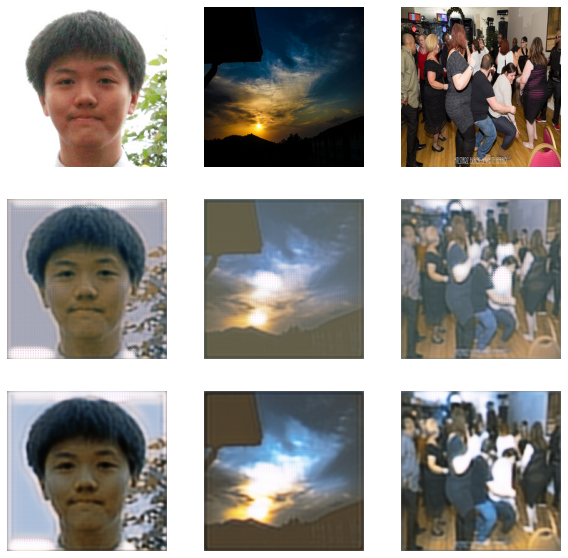

>401, loss_AB[9.407] loss_BA[8.181]
step 401
>402, loss_AB[7.434] loss_BA[8.141]
step 402
>403, loss_AB[5.396] loss_BA[5.934]
step 403
>404, loss_AB[5.243] loss_BA[4.316]
step 404
>405, loss_AB[3.644] loss_BA[3.182]
step 405
>406, loss_AB[4.349] loss_BA[4.226]
step 406
>407, loss_AB[7.992] loss_BA[7.206]
step 407
>408, loss_AB[5.314] loss_BA[4.812]
step 408
>409, loss_AB[9.608] loss_BA[7.943]
step 409
>410, loss_AB[6.554] loss_BA[5.586]
step 410
random_state 56


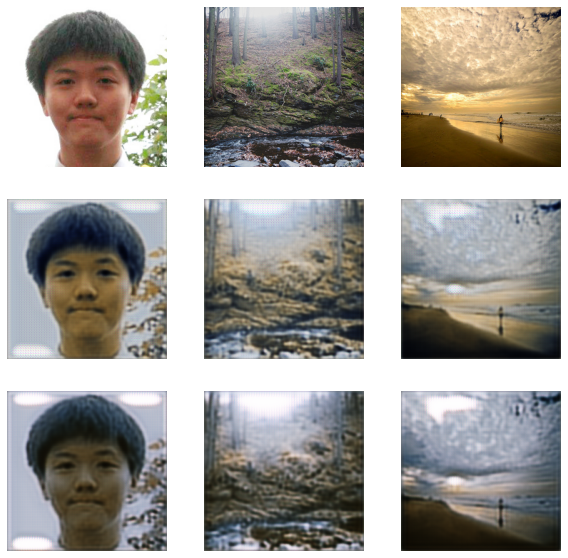

>411, loss_AB[4.129] loss_BA[4.068]
step 411
>412, loss_AB[5.832] loss_BA[5.019]
step 412
>413, loss_AB[7.149] loss_BA[6.110]
step 413
>414, loss_AB[5.542] loss_BA[5.008]
step 414
>415, loss_AB[5.841] loss_BA[5.195]
step 415
>416, loss_AB[4.685] loss_BA[4.825]
step 416
>417, loss_AB[6.723] loss_BA[5.759]
step 417
>418, loss_AB[5.752] loss_BA[5.975]
step 418
>419, loss_AB[5.232] loss_BA[4.724]
step 419
>420, loss_AB[6.288] loss_BA[5.637]
step 420
random_state 88


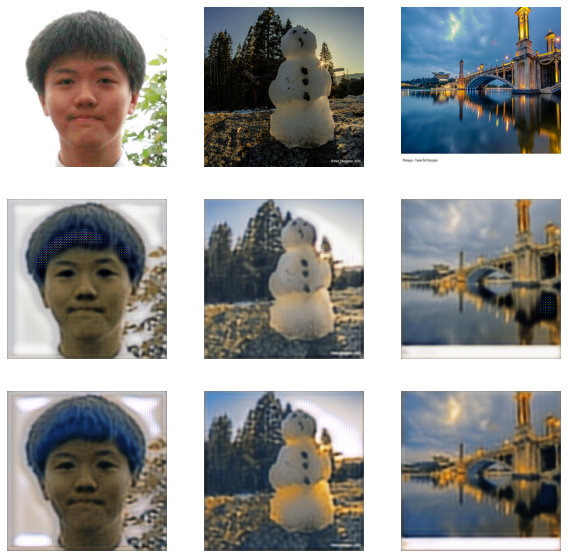

>421, loss_AB[7.599] loss_BA[6.652]
step 421
>422, loss_AB[8.519] loss_BA[7.538]
step 422
>423, loss_AB[6.825] loss_BA[5.760]
step 423
>424, loss_AB[5.690] loss_BA[5.484]
step 424
>425, loss_AB[4.789] loss_BA[4.680]
step 425
>426, loss_AB[7.254] loss_BA[6.485]
step 426
>427, loss_AB[6.730] loss_BA[7.042]
step 427
>428, loss_AB[11.051] loss_BA[11.518]
step 428
>429, loss_AB[6.187] loss_BA[5.850]
step 429
>430, loss_AB[8.963] loss_BA[8.315]
step 430
random_state 39


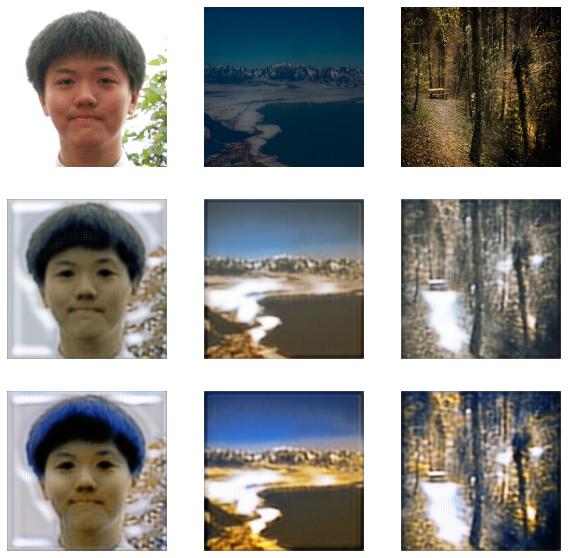

>431, loss_AB[8.544] loss_BA[7.803]
step 431
>432, loss_AB[6.555] loss_BA[6.740]
step 432
>433, loss_AB[6.303] loss_BA[5.792]
step 433
>434, loss_AB[12.185] loss_BA[9.697]
step 434
>435, loss_AB[9.581] loss_BA[8.419]
step 435
>436, loss_AB[7.859] loss_BA[5.703]
step 436
>437, loss_AB[7.002] loss_BA[5.165]
step 437
>438, loss_AB[5.256] loss_BA[4.956]
step 438
>439, loss_AB[6.476] loss_BA[6.828]
step 439
>440, loss_AB[4.640] loss_BA[3.676]
step 440
random_state 34


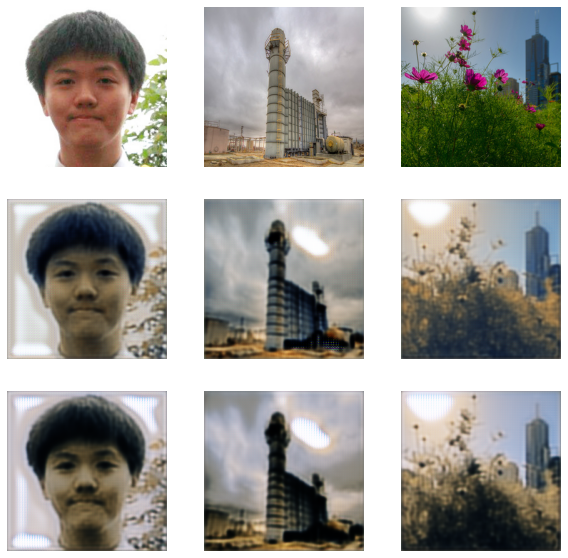

>441, loss_AB[8.816] loss_BA[8.954]
step 441
>442, loss_AB[8.192] loss_BA[7.492]
step 442
>443, loss_AB[6.674] loss_BA[5.795]
step 443
>444, loss_AB[6.583] loss_BA[6.135]
step 444
>445, loss_AB[9.381] loss_BA[7.767]
step 445
>446, loss_AB[7.620] loss_BA[7.295]
step 446
>447, loss_AB[4.724] loss_BA[4.530]
step 447
>448, loss_AB[4.519] loss_BA[4.609]
step 448
>449, loss_AB[6.295] loss_BA[6.412]
step 449
>450, loss_AB[6.492] loss_BA[5.489]
step 450
random_state 42


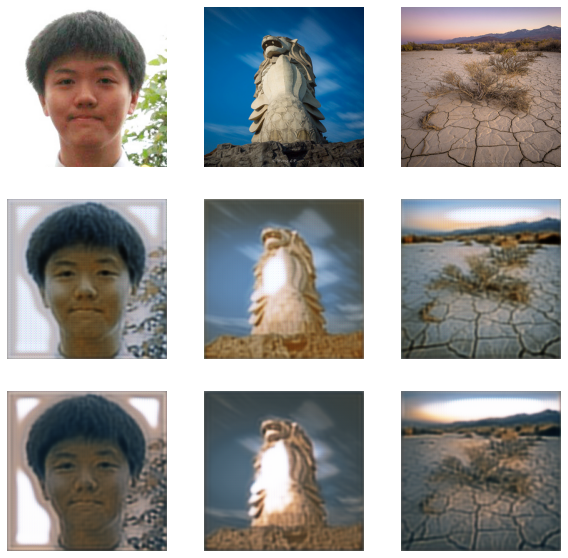

>451, loss_AB[5.505] loss_BA[4.884]
step 451
>452, loss_AB[6.361] loss_BA[7.230]
step 452
>453, loss_AB[7.000] loss_BA[5.104]
step 453
>454, loss_AB[11.631] loss_BA[8.564]
step 454
>455, loss_AB[6.675] loss_BA[5.524]
step 455
>456, loss_AB[7.827] loss_BA[6.472]
step 456
>457, loss_AB[6.578] loss_BA[5.456]
step 457
>458, loss_AB[6.463] loss_BA[5.528]
step 458
>459, loss_AB[5.491] loss_BA[5.552]
step 459
>460, loss_AB[6.145] loss_BA[5.796]
step 460
random_state 92


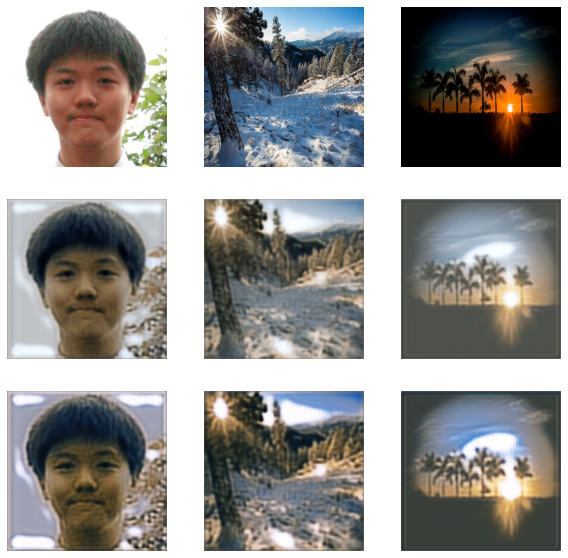

>461, loss_AB[4.130] loss_BA[3.972]
step 461
>462, loss_AB[6.579] loss_BA[5.725]
step 462
>463, loss_AB[5.707] loss_BA[5.500]
step 463
>464, loss_AB[8.459] loss_BA[8.134]
step 464
>465, loss_AB[5.377] loss_BA[5.424]
step 465
>466, loss_AB[4.473] loss_BA[3.874]
step 466
>467, loss_AB[6.618] loss_BA[5.546]
step 467
>468, loss_AB[4.321] loss_BA[3.600]
step 468
>469, loss_AB[11.155] loss_BA[11.871]
step 469
>470, loss_AB[6.213] loss_BA[5.451]
step 470
random_state 30


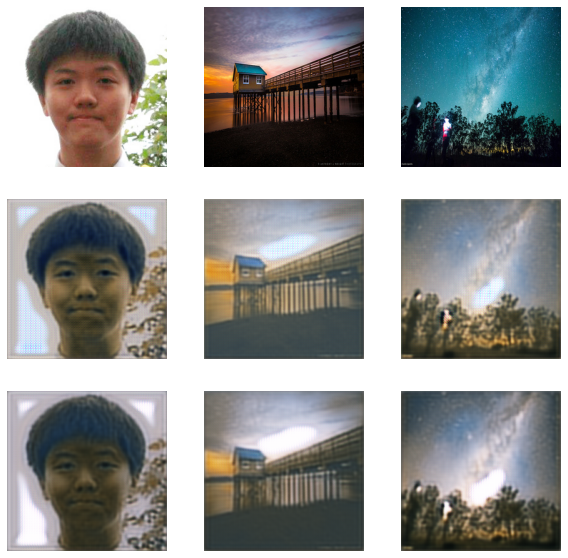

>471, loss_AB[8.076] loss_BA[7.513]
step 471
>472, loss_AB[7.139] loss_BA[6.314]
step 472
>473, loss_AB[5.919] loss_BA[5.251]
step 473
>474, loss_AB[8.531] loss_BA[9.748]
step 474
>475, loss_AB[7.919] loss_BA[6.785]
step 475
>476, loss_AB[7.572] loss_BA[7.013]
step 476
>477, loss_AB[5.288] loss_BA[5.188]
step 477
>478, loss_AB[7.291] loss_BA[6.329]
step 478
>479, loss_AB[7.331] loss_BA[7.556]
step 479
>480, loss_AB[4.825] loss_BA[4.966]
step 480
random_state 43


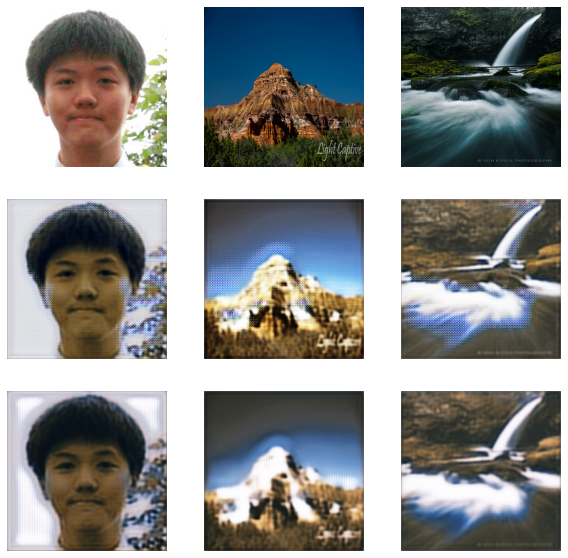

>481, loss_AB[7.549] loss_BA[7.345]
step 481
>482, loss_AB[8.013] loss_BA[7.075]
step 482
>483, loss_AB[6.970] loss_BA[7.050]
step 483
>484, loss_AB[9.259] loss_BA[8.358]
step 484
>485, loss_AB[4.163] loss_BA[4.363]
step 485
>486, loss_AB[5.981] loss_BA[5.820]
step 486
>487, loss_AB[5.726] loss_BA[5.866]
step 487
>488, loss_AB[5.854] loss_BA[5.191]
step 488
>489, loss_AB[7.039] loss_BA[6.003]
step 489
>490, loss_AB[4.556] loss_BA[3.328]
step 490
random_state 83


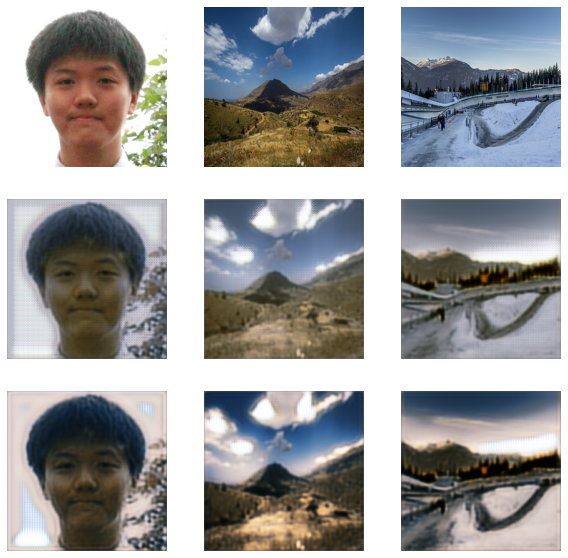

>491, loss_AB[5.654] loss_BA[5.261]
step 491
>492, loss_AB[5.669] loss_BA[4.447]
step 492
>493, loss_AB[8.173] loss_BA[6.726]
step 493
>494, loss_AB[6.516] loss_BA[6.588]
step 494
>495, loss_AB[5.597] loss_BA[4.574]
step 495
>496, loss_AB[7.127] loss_BA[5.999]
step 496
>497, loss_AB[6.133] loss_BA[5.537]
step 497
>498, loss_AB[7.592] loss_BA[6.480]
step 498
>499, loss_AB[6.308] loss_BA[6.373]
step 499
>500, loss_AB[5.475] loss_BA[5.291]


In [26]:
mse = MeanSquaredError()
mae = MeanAbsoluteError()

g_AB_opt = Adam(learning_rate = 0.0002, beta_1 = 0.5)
g_BA_opt = Adam(learning_rate=0.0002, beta_1=0.5)

d_A_opt = Adam(learning_rate = 0.0002, beta_1 = 0.5)
d_B_opt = Adam(learning_rate=0.0002, beta_1=0.5)

@tf.function
def add_loss(l1, l2, l3, l4):
  return l1 + 5*l2 + 10*l3 + 10*l4

for i in range(n_steps):
  print(f"step {i}")
  if i % 10 == 0:
    show_result(i)

  X_realA, y_realA = generate_real_samples("./monet2photo/trainA", n_batch, n_patch)
  X_realB, y_realB = generate_real_samples("./monet2photo/trainB", n_batch, n_patch)
  X_fakeA, y_fakeA = generate_fake_samples(g_model_BtoA, X_realB, n_patch)
  X_fakeB, y_fakeB = generate_fake_samples(g_model_AtoB, X_realA, n_patch)
  
  X_fakeA = update_image_pool(poolA, X_fakeA)
  X_fakeB = update_image_pool(poolB, X_fakeB)
  
  X_realA = tf.convert_to_tensor(X_realA)
  y_realA = tf.convert_to_tensor(y_realA)
  X_realB = tf.convert_to_tensor(X_realB)
  y_realB = tf.convert_to_tensor(y_realB)
  X_fakeA = tf.convert_to_tensor(X_fakeA)
  y_fakeA = tf.convert_to_tensor(y_fakeA)
  X_fakeB = tf.convert_to_tensor(X_fakeB)
  y_fakeB = tf.convert_to_tensor(y_fakeB)
  
  with tf.GradientTape() as gen_AB_tape, tf.GradientTape() as gen_BA_tape, tf.GradientTape() as disc_B_tape:
    critic_, output_B_id_, g_ABA_cycle_, g_BAB_cycle_ = c_model_AtoB([X_realA, X_realB])
    discrmininator_loss = mse(y_fakeA, critic_)
    identity_loss = mae(X_realB, output_B_id_)
    cycle_loss_ABA = mae(X_realA, g_ABA_cycle_)
    cycle_loss_BAB = mae(X_realB, g_BAB_cycle_)
    
    loss_AB = add_loss(discrmininator_loss, identity_loss, cycle_loss_ABA, cycle_loss_BAB)
  
    grad_of_gen_AB = gen_AB_tape.gradient(loss_AB, g_model_AtoB.trainable_variables)
    grad_of_gen_BA = gen_BA_tape.gradient(loss_AB, g_model_BtoA.trainable_variables)
    grad_of_disc_B = disc_B_tape.gradient(discrmininator_loss, d_model_B.trainable_variables)
  
  g_AB_opt.apply_gradients(zip(grad_of_gen_AB, g_model_AtoB.trainable_variables))
  g_BA_opt.apply_gradients(zip(grad_of_gen_BA, g_model_BtoA.trainable_variables))
  d_B_opt.apply_gradients(zip(grad_of_disc_B, d_model_B.trainable_variables))
  
  
  with tf.GradientTape() as gen_BA_tape, tf.GradientTape() as gen_AB_tape, tf.GradientTape() as disc_A_tape:
    critic_, output_A_id_, g_BAB_cycle_, g_ABA_cycle_ = c_model_BtoA([X_realB, X_realA])
    discrmininator_loss = mse(y_fakeB, critic_)
    identity_loss = mae(X_realA, output_A_id_)
    cycle_loss_BAB = mae(X_realB, g_BAB_cycle_)
    cycle_loss_ABA = mae(X_realA, g_ABA_cycle_)

    loss_BA = add_loss(discrmininator_loss, identity_loss, cycle_loss_BAB, cycle_loss_ABA)

    grad_of_gen_BA = gen_AB_tape.gradient(loss_BA, g_model_BtoA.trainable_variables)
    grad_of_gen_AB = gen_BA_tape.gradient(loss_BA, g_model_AtoB.trainable_variables)
    grad_of_disc_A = disc_A_tape.gradient(discrmininator_loss, d_model_A.trainable_variables)

  g_BA_opt.apply_gradients(zip(grad_of_gen_BA, g_model_BtoA.trainable_variables))
  g_AB_opt.apply_gradients(zip(grad_of_gen_AB, g_model_AtoB.trainable_variables))
  d_A_opt.apply_gradients(zip(grad_of_disc_A, d_model_A.trainable_variables))

  print('>%d, loss_AB[%.3f] loss_BA[%.3f]' % (i+1, loss_AB, loss_BA))


random_state 28


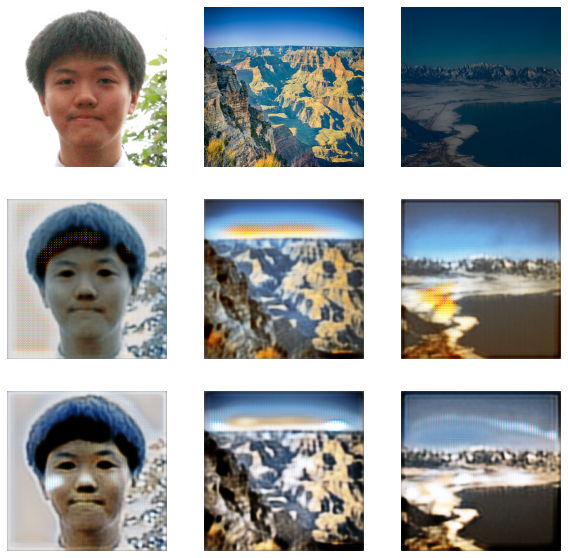

In [28]:
show_result(500)